# Studying channel condition number while moving along a trajectory

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from IPython.display import HTML

from neoradium import DeepMimoData, TrjChannel, Carrier, AntennaPanel, random
from neoradium.utils import toDb, toLinear


In [2]:
# Replace this with the folder on your computer where you store DeepMIMO scenarios
dataFolder = "/data/RayTracing/DeepMIMO/Scenarios/V4/"
DeepMimoData.setScenariosPath(dataFolder)

# Create a DeepMimoData object
deepMimoData = DeepMimoData("asu_campus_3p5")
deepMimoData.print()


DeepMimoData Properties:
  Scenario:                   asu_campus_3p5
  Version:                    4.0.0a3
  UE Grid:                    rx_grid
  Grid Size:                  411 x 321
  Base Station:               BS (at [166. 104.  22.])
  Total Grid Points:          131,931
  UE Spacing:                 [1. 1.]
  UE bounds (xyMin, xyMax)    [-225.55 -160.17], [184.45 159.83]
  UE Height:                  1.50
  Carrier Frequency:          3.5 GHz
  Num. paths (Min, Avg, Max): 0, 6.21, 10
  Num. total blockage:        46774
  LOS percentage:             19.71%




Trajectory Properties:
  start (x,y,z):         (-164.55, 39.83, 1.50)
  No. of points:         8227
  curIdx:                0 (0.00%)
  curSpeed:              [10.64 10.64  0.  ]
  Total distance:        123.44 meters
  Total time:            8.226 seconds
  Average Speed:         15.006 m/s
  Carrier Frequency:     3.5 GHz
  Paths (Min, Avg, Max): 6, 8.99, 10
  Totally blocked:       0
  LOS percentage:        26.43%



(<Figure size 742.518x471.734 with 1 Axes>,
 <Axes: title={'center': 'Map of LOS/NLOS paths'}, xlabel='X', ylabel='Y'>)

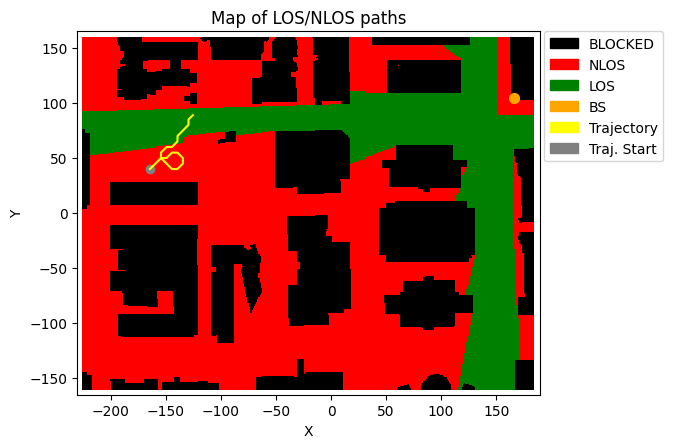

In [3]:
random.setSeed(123)                                 # Make results reproducible

# Create the carrier:
carrier = Carrier(startRb=0, numRbs=25, spacing=15) # Carrier with 25 Resource Blocks, 15KHz subcarrier spacing
bwp = carrier.curBwp                                # The only bandwidth part in the carrier

# Create a random trajectory at waking speed.
trajectory = deepMimoData.getRandomTrajectory(xyBounds=np.array([[-210, 40], [-120, 100]]),   # Traj. bounds
                                              segLen=5,               # Num grid points on shortest segment
                                              bwp=bwp,                # The bandwidth part
                                              trajLen=100,            # Number of grid points on trajectory
                                              speedMps=15)            # Speed in mps

trajectory.print()                                  # Print the trajectory information
deepMimoData.drawMap("LOS-NLOS", trajectory)        # Draw the Map with the trajectory

In [4]:
channel = TrjChannel(bwp, trajectory,
                     txAntenna = AntennaPanel([2,4]),  # 8 TX antenna
                     txOrientation = [180,0,0],        # TX antenna pointing to the left
                     rxAntenna = AntennaPanel([1,2]),  # 2 RX antenna
                     seed = 123)
print(channel)

def getConditionNumber(channelMatrix):
    # Condition Number:
    # CN(H) = 20 log (sigmaMax/sigmaMin)
    # **NOTE**: As you can see ``CN`` is given in logarithmic scale in db. The values between 0 and
    # 10 db are usually considered good for beam-forming while the values above 20 db are considered 
    # unusable for beam-forming.
    u, s, v = np.linalg.svd(channelMatrix)
    cn = 2*toDb(s.max(2)/s.min(2))
    return cn.min(), cn.mean(), cn.max()

# A call back function that is called to draw up to three graphs below the animated trajectory
prevInfo = [0,0,0,0]
def handleGraph(request, ax, trajectory, points=None):
    if request=="Config":
        # Configure all graphs
        if len(ax)>0:
            ax[0].set_xlim(0,trajectory.numPoints)
            ax[0].set_title("Condition Number (dB)")
            ax[0].grid()
        if len(ax)>1:
            ax[1].set_xlim(0,trajectory.numPoints)
            ax[1].set_title("Number of paths")
            ax[1].grid()

    elif request=="Draw":
        # For Draw: ax is an array of `numGraphs` elements
        p0, p1 = points
        cnMin, cnMean, cnMax, numPaths = [], [], [], []
        while channel.trajectory.curIdx < p1:
            channelMatrix = channel.getChannelMatrix()                      # Get the channel matrix
            cn = getConditionNumber( channel.getChannelMatrix() )
            cnMin += [cn[0]]
            cnMean += [cn[1]]
            cnMax += [cn[2]]
            numPaths += [channel.numPaths]
            channel.goNext()
        cnMin, cnMean, cnMax, numPaths = min(cnMin), np.mean(cnMean), max(cnMax), np.mean(numPaths)

        global prevInfo
        prevMin, prevMean, prevMax, prevNumPaths = prevInfo
        if len(ax)>0:
            ax[0].plot([p0,p1], [prevMean,  cnMean], 'red', markersize=1, label=f"Avg.")
            ax[0].fill_between([p0,p1], [prevMin,  cnMin], [prevMax,  cnMax], color='pink', alpha=0.5, label='Range')
        if len(ax)>1: # Set 'numGraphs' to 2 to draw the number of paths in the second graph
            ax[1].plot([p0,p1], [prevNumPaths,  numPaths], 'blue', markersize=1, label=f"Number of Paths")
        prevInfo = [cnMin, cnMean, cnMax, numPaths]

        print("\r Current Trajectory Point: %d (%d%%)    "%(trajectory.curIdx, 
                                                            trajectory.curIdx*100//trajectory.numPoints), end="")




TrjChannel Properties:
  carrierFreq:          3.5 GHz
  normalizeGains:       True
  normalizeOutput:      True
  normalizeDelays:      True
  xPolPower:            10.00 (dB)
  filterLen:            16 samples
  delayQuantSize:       64
  stopBandAtten:        80 dB
  dopplerShift:         175.6448069011776 Hz
  coherenceTime:        0.0024090788399960396 sec
  TX Antenna:
    Total Elements:     8
    spacing:            0.5𝜆, 0.5𝜆
    shape:              2 rows x 4 columns
    polarization:       |
    Orientation (𝛼,𝛃,𝛄): 180° 0° 0°
  RX Antenna:
    Total Elements:     2
    spacing:            0.5𝜆, 0.5𝜆
    shape:              1 rows x 2 columns
    polarization:       |
  Trajectory:
    start (x,y,z):         (-164.55, 39.83, 1.50)
    No. of points:         8227
    curIdx:                0 (0.00%)
    curSpeed:              [10.64 10.64  0.  ]
    Total distance:        123.44 meters
    Total time:            8.226 seconds
    Average Speed:         15.006 m/s
    Carrier

In [5]:
# Increase the animation memory limit to 100 MB
matplotlib.rcParams['animation.embed_limit'] = 100000000

# Now create the animation and display it in the following cell. This can take a while...
channel.restart()
anim = deepMimoData.animateTrajectory(trajectory, numGraphs=1, pointsPerFrame=20, graphCallback=handleGraph)
HTML(anim.to_jshtml())


 Current Trajectory Point: 8200 (99%)    